In [5]:
import time
import numpy as np
import bezier
from enum import IntEnum
import math
import matplotlib.pyplot as plt

In [ ]:
class Motor(IntEnum):
    # identifies the corresponding pin location with the motor location
    FL_HIP = 1
    FL_SHOULDER = 2
    FL_ELBOW = 3
    BL_HIP = 4
    BL_SHOULDER = 5
    BL_ELBOW = 6
    FR_HIP = 7
    FR_SHOULDER = 8
    FR_ELBOW = 9
    BR_HIP = 10
    BR_SHOULDER = 11
    BR_ELBOW = 12

    FL_HIP_OFFSET = 0
    FL_SHOULDER_OFFSET = 0
    FL_ELBOW_OFFSET = 0
    BL_HIP_OFFSET = 0
    BL_SHOULDER_OFFSET = 0
    BL_ELBOW_OFFSET = 0
    FR_HIP_OFFSET = 0
    FR_SHOULDER_OFFSET = 0
    FR_ELBOW_OFFSET = 0
    BR_HIP_OFFSET = 0
    BR_SHOULDER_OFFSET = 0
    BR_ELBOW_OFFSET = 0

    @classmethod
    def to_offset(cls, motor):
        # Mapping motor to its corresponding offset
        offset_mapping = {
            cls.FL_HIP: cls.FL_HIP_OFFSET,
            cls.FL_SHOULDER: cls.FL_SHOULDER_OFFSET,
            cls.FL_ELBOW: cls.FL_ELBOW_OFFSET,
            cls.BL_HIP: cls.BL_HIP_OFFSET,
            cls.BL_SHOULDER: cls.BL_SHOULDER_OFFSET,
            cls.BL_ELBOW: cls.BL_ELBOW_OFFSET,
            cls.FR_HIP: cls.FR_HIP_OFFSET,
            cls.FR_SHOULDER: cls.FR_SHOULDER_OFFSET,
            cls.FR_ELBOW: cls.FR_ELBOW_OFFSET,
            cls.BR_HIP: cls.BR_HIP_OFFSET,
            cls.BR_SHOULDER: cls.BR_SHOULDER_OFFSET,
            cls.BR_ELBOW: cls.BR_ELBOW_OFFSET
        }
        
        # Return the offset for the specified motor
        return offset_mapping.get(motor, None)
        

class Robotdog:
    def __init__(self) -> None:
        # self.kit = ServoKit(channels=16)
        self.upper_leg_length = 10
        self.lower_leg_length = 10
        # for i in range(10):
        #     self.kit.servo[i].set_pulse_width_range(500,2500)

    def set_angle(self, motor_id: Motor, degrees: int):
        # self.kit.servo[motor_id].angle = degrees
        print("Move motor_id: ", motor_id, "to angle: ", degrees)

    def rad_to_degree(self, rad):
        return rad*180/math.pi
    
    def calibrate(self):
        self.set_angle(Motor.FL_HIP, 90)
        self.set_angle(Motor.FL_SHOULDER, 20)
        self.set_angle(Motor.FL_ELBOW, 140)
        self.set_angle(Motor.FR_HIP, 90)
        self.set_angle(Motor.FR_SHOULDER, 160)
        self.set_angle(Motor.FR_ELBOW, 50)
        self.set_angle(Motor.BL_HIP, 90)
        self.set_angle(Motor.BL_SHOULDER, 20)
        self.set_angle(Motor.BL_ELBOW, 140)
        self.set_angle(Motor.BR_HIP, 90)
        self.set_angle(Motor.BR_SHOULDER, 180)
        self.set_angle(Motor.BR_ELBOW, 20)

    def standup(self):
        self.set_angle(Motor.FL_HIP, 90)
        self.set_angle(Motor.FL_SHOULDER, 70)
        self.set_angle(Motor.FL_ELBOW, 110)
        self.set_angle(Motor.FR_HIP, 90)
        self.set_angle(Motor.FR_SHOULDER, 110)
        self.set_angle(Motor.FR_ELBOW, 70)
        self.set_angle(Motor.BL_HIP, 90)
        self.set_angle(Motor.BL_SHOULDER, 70)
        self.set_angle(Motor.BL_ELBOW, 130)
        self.set_angle(Motor.BR_HIP, 90)
        self.set_angle(Motor.BR_SHOULDER, 110)
        self.set_angle(Motor.BR_ELBOW, 50)

    def inverse_positioning(self, shoulder, elbow, x, y, z=0, hip=None, right=True):
        '''
        Positions the end effector at a given position based on cartesian coordinates in 
        centimeter units and with respect to the should motor of the
        :param shoulder: motor id used for the shoulder
        :param elbow: motor id used for the elbow
        :param x: cartesian x with respect to shoulder motor (forward/back)
        :param y: cartesian y with respect to shoulder motor (up/down)
        :param z: cartesian z with respect to shoulder motor (left/right)
        :param hip: motor id used for the hip
        :param right: a boolean that flips the logic for left and right side to properly map "forward direction"
        :return: a list containing the appropriate angle for the shoulder and elbow
        '''
        L=2
        # 距離
        y_prime = -math.sqrt((z+L)**2 + y**2)
        thetaz = math.atan2(z+L,abs(y))-math.atan2(L,abs(y_prime))

        elbow_offset = 20
        shoulder_offset = 10
        a1 = self.upper_leg_length
        a2 = self.lower_leg_length

        c2 = (x**2+y_prime**2-a1**2-a2**2)/(2*a1*a2)
        s2 = math.sqrt(1-c2**2)
        theta2 = math.atan2(s2,c2)
        c2 = math.cos(theta2)
        s2 = math.sin(theta2)

        c1 = (x*(a1+(a2*c2)) + y_prime*(a2*s2))/(x**2+y_prime**2)
        s1 = (y_prime*(a1+(a2*c2)) - x*(a2*s2))/(x**2+y_prime**2)
        theta1 = math.atan2(s1,c1)
        # generate positions with respect to robot motors
        theta_shoulder = -theta1
        theta_elbow = theta_shoulder - theta2
        theta_hip = 0
        if right:
            theta_shoulder = 180 - self.rad_to_degree(theta_shoulder) + shoulder_offset
            theta_elbow = 130 - self.rad_to_degree(theta_elbow) + elbow_offset
            if hip:
                theta_hip = 90 - self.rad_to_degree(thetaz)
        else:
            theta_shoulder = self.rad_to_degree(theta_shoulder) - shoulder_offset
            theta_elbow = 50 + self.rad_to_degree(theta_elbow) - elbow_offset
            if hip:
                theta_hip = 90 + self.rad_to_degree(thetaz)
        self.set_angle(shoulder, theta_shoulder)
        self.set_angle(elbow, theta_elbow)
        if hip:
            self.set_angle(hip, theta_hip)
        print("theta shoulder:",theta_shoulder,"\ttheta_elbow:",theta_elbow)
        return [theta_shoulder, theta_elbow]

    def leg_position(self, leg_id, x, y, z=0):
        """
        wrapper for inverse position that makes it easier to control each leg for making fixed paths
        :param led_id: string for the leg to be manipulated
        :param x: cartesian x with respect to shoulder motor (forward/back)
        :param y: cartesian y with respect to shoulder motor (up/down)
        :param z: cartesian z with respect to shoulder motor (left/right)
        """
        if leg_id == 'FL':
            self.inverse_positioning(Motor.FL_SHOULDER, Motor.FL_ELBOW, x, y, z=z, hip=Motor.FL_HIP, right=False)
        if leg_id == 'FR':
            self.inverse_positioning(Motor.FR_SHOULDER, Motor.FR_ELBOW, x, y, z=z, hip=Motor.FR_HIP, right=True)
        if leg_id == 'BL':
            self.inverse_positioning(Motor.BL_SHOULDER, Motor.BL_ELBOW, x, y, right=False)
        if leg_id == 'BR':
            self.inverse_positioning(Motor.BR_SHOULDER, Motor.BR_ELBOW, x, y, right=True)
    
    def move(self, controller=None):
        """
        Walks around based on the controller inputted momentum
        :param controller: the controller that is called to determine the robot momentum
        :returns: None, enters an infinite loop 
        """
        momentum = np.asarray([0,0,1,0],dtype=np.float32)  # 前三個值 x(前後), z(左右), y(上下) 為步伐大小的縮放值, 第四個值不為 0 時結束動作
        index = 0
        
        # Generate footstep
        s_vals = np.linspace(0.0, 1.0, 20)  # from 0 to 1, sperate to 20 point
        step_nodes = np.asfortranarray([  # define the curve using these four points -> bezier curve
            [-1.0, -1.0, 1.0, 1.0],
            [-1.0, -1.0, 1.0, 1.0],
            [-15.0, -10, -10, -15.0],
        ])
        curve = bezier.Curve(step_nodes, degree=3)
        step = curve.evaluate_multi(s_vals)
        slide_nodes = np.asfortranarray([
            [1.0, -1.0],
            [1.0, -1.0],
            [-15.0, -15],
        ])
        curve = bezier.Curve(slide_nodes, degree=1)
        slide = curve.evaluate_multi(s_vals)

        motion = np.concatenate((step,slide), axis=1)

        close = False
        while not close:
            momentum = controller(momentum)
            tragectory = motion * momentum[:3, None]
            if momentum[3]:
                close = True
            x,z,y = tragectory
            # 
            i1 = index%40
            i2 = (index+20)%40 
            # Apply movement based movement
            print("moving to: ( ", x[i1], y[i1], ")")
            self.inverse_positioning(Motor.FL_SHOULDER,Motor.FL_ELBOW,x[i1],y[i1]-1,z=z[i1],hip=Motor.FR_HIP,right=True)
            
            index += 1

def controller(momentum):
    momentum[:3] = [4, 0, 1]
    return momentum


if __name__ == '__main__':
    robotdog = Robotdog()
    
    print("Calibrating robot dog to default position...")
    robotdog.calibrate()
    time.sleep(2)
    robotdog.standup()
    time.sleep(2)
    
    momentum = np.asarray([1, 0, 1, 0], dtype=np.float32)  # 最後一個值為 0 表示不關閉

    print("Starting robot dog movement. Press Ctrl+C to stop.")
    try:
        robotdog.move(lambda m: controller(momentum))  # 使用 lambda 傳遞 momentum 給 controller
    except KeyboardInterrupt:
        print("\nCtrl+C detected! Sending stop signal to robot dog...")

        momentum[3] = 1
        time.sleep(1)
        robotdog.calibrate()
        print("Movement stopped by user. Exiting program.")

Calibrating robot dog to default position...
Move motor_id:  Motor.FL_HIP to angle:  90
Move motor_id:  Motor.FL_SHOULDER to angle:  20
Move motor_id:  Motor.FL_ELBOW to angle:  140
Move motor_id:  Motor.FR_HIP to angle:  90
Move motor_id:  Motor.FR_SHOULDER to angle:  160
Move motor_id:  Motor.FR_ELBOW to angle:  50
Move motor_id:  Motor.BL_HIP to angle:  90
Move motor_id:  Motor.BL_SHOULDER to angle:  20
Move motor_id:  Motor.BL_ELBOW to angle:  140
Move motor_id:  Motor.BR_HIP to angle:  90
Move motor_id:  Motor.BR_SHOULDER to angle:  180
Move motor_id:  Motor.BR_ELBOW to angle:  20
Move motor_id:  Motor.FL_HIP to angle:  90
Move motor_id:  Motor.FL_SHOULDER to angle:  70
Move motor_id:  Motor.FL_ELBOW to angle:  110
Move motor_id:  Motor.FR_HIP to angle:  90
Move motor_id:  Motor.FR_SHOULDER to angle:  110
Move motor_id:  Motor.FR_ELBOW to angle:  70
Move motor_id:  Motor.BL_HIP to angle:  90
Move motor_id:  Motor.BL_SHOULDER to angle:  70
Move motor_id:  Motor.BL_ELBOW to angle:  

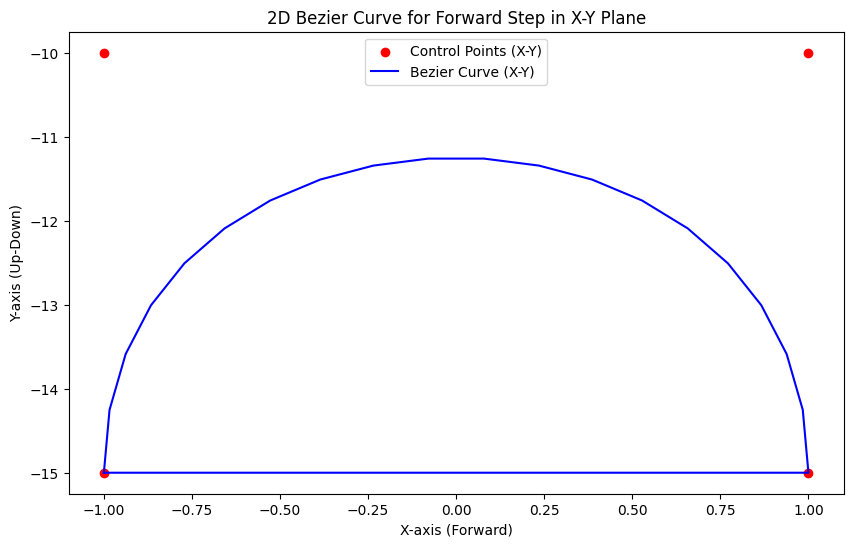

In [20]:
step_nodes = np.asfortranarray([
    [-1.0, -1.0, 1.0, 1.0],
    [0.0, 0.0, 0.0, 0.0],
    [-15.0, -10.0, -10.0, -15.0]
])

# 創建一條三階貝茲曲線
curve = bezier.Curve(step_nodes, degree=3)

# 計算貝茲曲線上的點（公式定義範圍必須為 0 到 1，細分成 20 個點來繪製平滑曲線）
s_vals = np.linspace(0.0, 1.0, 20)
step = curve.evaluate_multi(s_vals)

slide_nodes = np.asfortranarray([
            [1.0, -1.0],
            [1.0, -1.0],
            [-15.0, -15],
        ])
curve = bezier.Curve(slide_nodes, degree=1)
slide = curve.evaluate_multi(s_vals)

motion = np.concatenate((step,slide), axis=1)

# 創建 Matplotlib 圖像
fig = plt.figure(figsize=(10, 6))

# 繪製 2D 圖像，僅在 X-Y 平面上
ax2d = fig.add_subplot(111)
# 繪製控制點
ax2d.scatter(step_nodes[0], step_nodes[2], color='red', label='Control Points (X-Y)')
# 繪製貝茲曲線
ax2d.plot(motion[0], motion[2], color='blue', label='Bezier Curve (X-Y)')

# 設置標籤和圖例
ax2d.set_xlabel("X-axis (Forward)")
ax2d.set_ylabel("Y-axis (Up-Down)")
ax2d.legend()
ax2d.set_title("2D Bezier Curve for Forward Step in X-Y Plane")

# 顯示圖像
plt.show()

theta_shoulder =  113.69234614998787
theta_elbow =  36.695224312901814


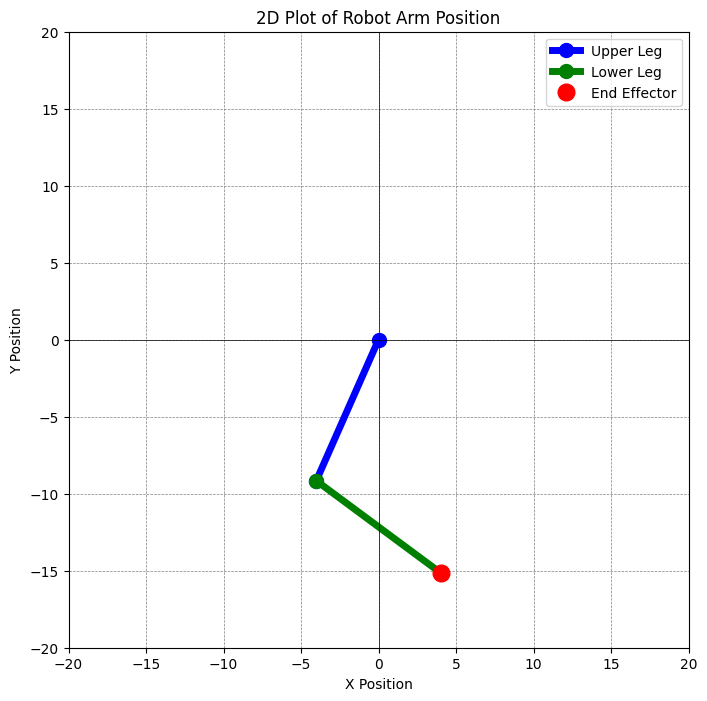

In [47]:
L=2
x, z, y = 4, 0, -15
upper_leg_length = 10
lower_leg_length = 10
y_prime = -math.sqrt((z+L)**2 + y**2)
thetaz = math.atan2(z+L,abs(y))-math.atan2(L,abs(y_prime))

elbow_offset = 20
shoulder_offset = 10
a1 = upper_leg_length
a2 = lower_leg_length

c2 = (x**2+y_prime**2-a1**2-a2**2)/(2*a1*a2)
s2 = math.sqrt(1-c2**2)
theta2 = math.atan2(s2,c2)
c2 = math.cos(theta2)
s2 = math.sin(theta2)

c1 = (x*(a1+(a2*c2)) + y_prime*(a2*s2))/(x**2+y_prime**2)
s1 = (y_prime*(a1+(a2*c2)) - x*(a2*s2))/(x**2+y_prime**2)
theta1 = math.atan2(s1,c1)
# generate positions with respect to robot motors
theta_shoulder = -theta1
theta_elbow = theta_shoulder - theta2

print("theta_shoulder = ", theta_shoulder*180/math.pi)
print("theta_elbow = ", theta_elbow*180/math.pi)

shoulder_x, shoulder_y = 0, 0
elbow_x = shoulder_x + a1 * math.cos(-theta_shoulder)
elbow_y = shoulder_y + a1 * math.sin(-theta_shoulder)
end_effector_x = elbow_x + a2 * math.cos(-theta_elbow)
end_effector_y = elbow_y + a2 * math.sin(-theta_elbow)

plt.figure(figsize=(8, 8))
plt.plot([shoulder_x, elbow_x], [shoulder_y, elbow_y], 'b-o', linewidth=5, markersize=10, label="Upper Leg")  # 上段臂
plt.plot([elbow_x, end_effector_x], [elbow_y, end_effector_y], 'g-o', linewidth=5, markersize=10, label="Lower Leg")  # 下段臂
plt.plot(end_effector_x, end_effector_y, 'ro', markersize=12, label="End Effector")  # 終端點

# 設置圖表參數
plt.xlim(-20, 20)
plt.ylim(-20, 20)
plt.axhline(0, color='black',linewidth=0.5)
plt.axvline(0, color='black',linewidth=0.5)
plt.grid(color = 'gray', linestyle = '--', linewidth = 0.5)
plt.xlabel("X Position")
plt.ylabel("Y Position")
plt.title("2D Plot of Robot Arm Position")
plt.legend()
plt.show()

index:  0  (  -4.0 -15.0  )
0.22500000000000014
theta_shoulder =  143.30477568709819
theta_elbow =  66.30765385001212
index:  1  (  -3.9358507071001614 -14.252077562326875  )
0.11306317815580982
theta_shoulder =  147.0492986605375
theta_elbow =  63.54122336621924
index:  2  (  -3.752733634640619 -13.58725761772853  )
0.013482896515424727
theta_shoulder =  149.89676033022553
theta_elbow =  60.66929680375097
index:  3  (  -3.464644991981338 -13.005540166204986  )
-0.07426080032383708
theta_shoulder =  151.88068472110103
theta_elbow =  57.621933880815604
index:  4  (  -3.0855809884822865 -12.506925207756233  )
-0.1502800590555421
theta_shoulder =  153.0129747915825
theta_elbow =  54.369818057722014
index:  5  (  -2.6295378335034267 -12.091412742382273  )
-0.21441634337764853
theta_shoulder =  153.30022061821361
theta_elbow =  50.91893290220574
index:  6  (  -2.1105117364047237 -11.759002770083104  )
-0.26635797031837893
theta_shoulder =  152.75786217467416
theta_elbow =  47.31020293688731

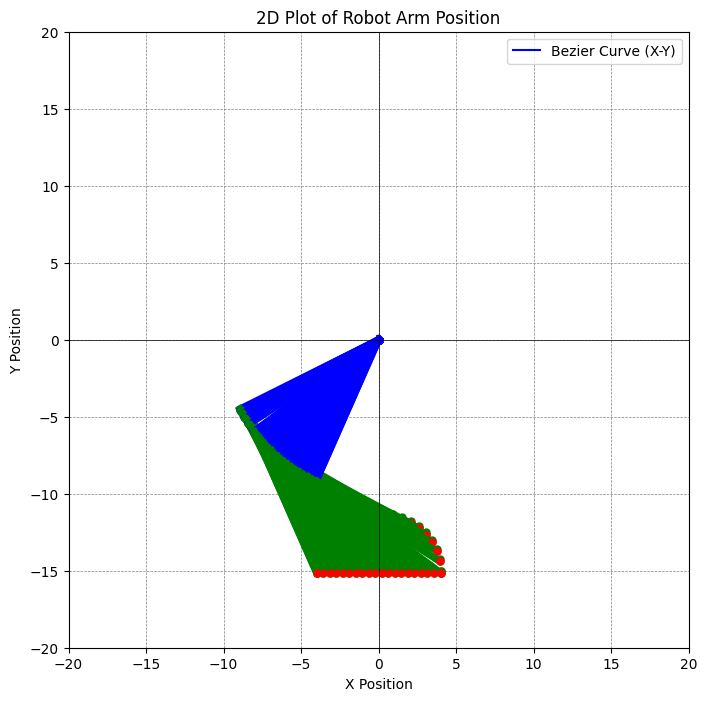

In [48]:
plt.figure(figsize=(8, 8))
plt.plot(motion[0], motion[2], color='blue', label='Bezier Curve (X-Y)')

momentum = np.asarray([4,0,1,0],dtype=np.float32)

for index in range(40):
    L=2
    tragectory = motion * momentum[:3, None]
    x_all,z_all,y_all = tragectory
    x = x_all[index]
    y = y_all[index]
    z = z_all[index]
    print("index: ", index, " ( ", x, y, " )")
    upper_leg_length = 10
    lower_leg_length = 10
    y_prime = -math.sqrt((z+L)**2 + y**2)
    thetaz = math.atan2(z+L,abs(y))-math.atan2(L,abs(y_prime))

    elbow_offset = 20
    shoulder_offset = 10
    a1 = upper_leg_length
    a2 = lower_leg_length

    c2 = (x**2+y_prime**2-a1**2-a2**2)/(2*a1*a2)
    print(c2)
    s2 = math.sqrt(1-c2**2)
    theta2 = math.atan2(s2,c2)
    c2 = math.cos(theta2)
    s2 = math.sin(theta2)

    c1 = (x*(a1+(a2*c2)) + y_prime*(a2*s2))/(x**2+y_prime**2)
    s1 = (y_prime*(a1+(a2*c2)) - x*(a2*s2))/(x**2+y_prime**2)
    theta1 = math.atan2(s1,c1)
    # generate positions with respect to robot motors
    theta_shoulder = -theta1
    theta_elbow = theta_shoulder - theta2

    print("theta_shoulder = ", theta_shoulder*180/math.pi)
    print("theta_elbow = ", theta_elbow*180/math.pi)

    shoulder_x, shoulder_y = 0, 0
    elbow_x = shoulder_x + a1 * math.cos(-theta_shoulder)
    elbow_y = shoulder_y + a1 * math.sin(-theta_shoulder)
    end_effector_x = elbow_x + a2 * math.cos(-theta_elbow)
    end_effector_y = elbow_y + a2 * math.sin(-theta_elbow)
    plt.plot(x, y, 'go', markersize=5)
    plt.plot([shoulder_x, elbow_x], [shoulder_y, elbow_y], 'b-o', linewidth=5, markersize=5)  # 上段臂
    plt.plot([elbow_x, end_effector_x], [elbow_y, end_effector_y], 'g-o', linewidth=5, markersize=5)  # 下段臂
    plt.plot(end_effector_x, end_effector_y, 'ro', markersize=5)  # 終端點

# 設置圖表參數
plt.xlim(-20, 20)
plt.ylim(-20, 20)
plt.axhline(0, color='black',linewidth=0.5)
plt.axvline(0, color='black',linewidth=0.5)
plt.grid(color = 'gray', linestyle = '--', linewidth = 0.5)
plt.xlabel("X Position")
plt.ylabel("Y Position")
plt.title("2D Plot of Robot Arm Position")
plt.legend()
plt.show()

In [ ]:
motion

array([[ -1.        ,  -0.98396268,  -0.93818341,  -0.86616125,
         -0.77139525,  -0.65738446,  -0.52762793,  -0.38562473,
         -0.23487389,  -0.07887447,   0.07887447,   0.23487389,
          0.38562473,   0.52762793,   0.65738446,   0.77139525,
          0.86616125,   0.93818341,   0.98396268,   1.        ,
          1.        ,   0.89473684,   0.78947368,   0.68421053,
          0.57894737,   0.47368421,   0.36842105,   0.26315789,
          0.15789474,   0.05263158,  -0.05263158,  -0.15789474,
         -0.26315789,  -0.36842105,  -0.47368421,  -0.57894737,
         -0.68421053,  -0.78947368,  -0.89473684,  -1.        ],
       [  0.        ,   0.        ,   0.        ,   0.        ,
          0.        ,   0.        ,   0.        ,   0.        ,
          0.        ,   0.        ,   0.        ,   0.        ,
          0.        ,   0.        ,   0.        ,   0.        ,
          0.        ,   0.        ,   0.        ,   0.        ,
          1.        ,   0.89473684,   0